# Style Transfer with Deep Neural Networks


In this notebook, we’ll *recreate* a style transfer method that is outlined in the paper, [Image Style Transfer Using Convolutional Neural Networks, by Gatys](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf) in PyTorch.

In this paper, style transfer uses the features found in the 19-layer VGG Network, which is comprised of a series of convolutional and pooling layers, and a few fully-connected layers. In the image below, the convolutional layers are named by stack and their order in the stack. Conv_1_1 is the first convolutional layer that an image is passed through, in the first stack. Conv_2_1 is the first convolutional layer in the *second* stack. The deepest convolutional layer in the network is conv_5_4.

<img src='notebook_ims/vgg19_convlayers.png' width=80% />

### Separating Style and Content

Style transfer relies on separating the content and style of an image. Given one content image and one style image, we aim to create a new, _target_ image which should contain our desired content and style components:
* objects and their arrangement are similar to that of the **content image**
* style, colors, and textures are similar to that of the **style image**

In this notebook, we'll use a pre-trained VGG19 Net to extract content or style features from a passed in image. We'll then formalize the idea of content and style _losses_ and use those to iteratively update our target image until we get a result that we want.

In [1]:
# import resources
%matplotlib inline

from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.optim as optim
from torchvision import transforms, models

## Load Vgg 19

In [2]:
# get the "features" portion of VGG19 (we will not need the "classifier" portion)
vgg = models.vgg19(pretrained=True).features

# freeze all VGG parameters since we're only optimizing the target image
for param in vgg.parameters():
    param.requires_grad_(False)

In [3]:
# move the model to GPU, if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace)
  (18): MaxPool2d(kernel_size=2, stride=2, padding=0, 

In [4]:
def load_image(img_path, max_size=400, shape=None):
    ''' Load in and transform an image, making sure the image
       is <= 400 pixels in the x-y dims.'''
    
    image = Image.open(img_path).convert('RGB')
    
    # large images will slow down processing
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape
        
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # discard the transparent, alpha channel (that's the :3) and add the batch dimension
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

In [5]:
# load in content and style image
content_image_names = ['1.jpg','2.jpg','3.jpg','4.jpg','5.jpg']
style_image_names = ['Battal/b1.jpg','Gelgit/g1.jpg','Ispanyol/i1.jpg','Istridye/is1.jpg','Tarak/t1.jpg']

contents = []
styles = []

for i in range(len(content_image_names)):
    contents.append(load_image('Content/' + content_image_names[i]).to(device))
    # Resize style to match content, makes code easier
    styles.append(load_image('EBRU/' + style_image_names[i], shape=contents[i].shape[-2:]).to(device))

In [6]:
# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

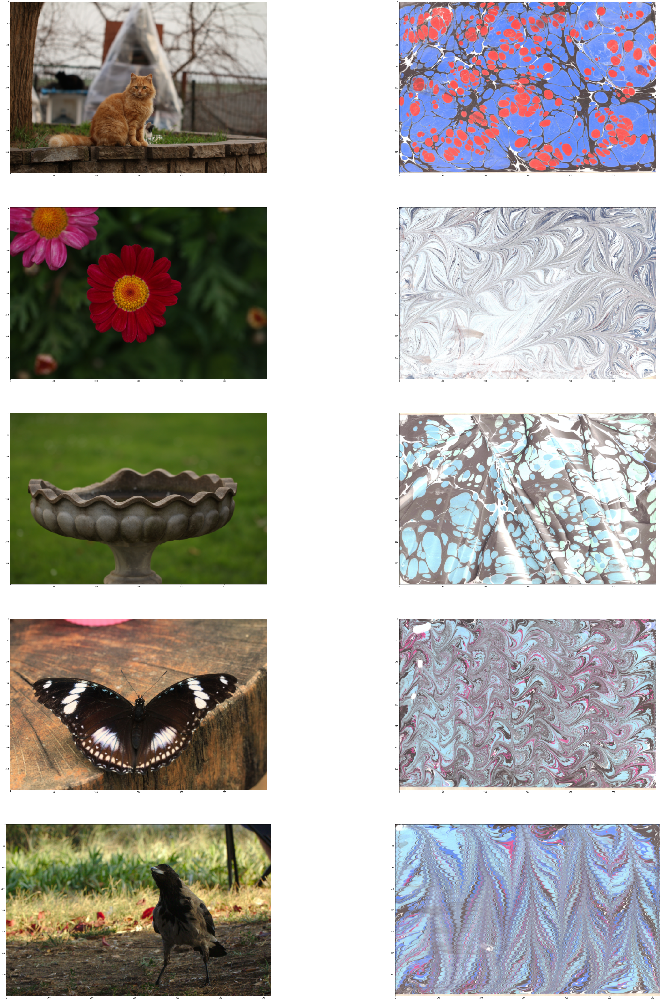

In [7]:
# display the images
fig, axs = plt.subplots(5, 2, figsize=(70, 100))
# content and style ims side-by-side

axs[0][0].imshow(im_convert(contents[0]))
axs[0][1].imshow(im_convert(styles[0]))

axs[1][0].imshow(im_convert(contents[1]))
axs[1][1].imshow(im_convert(styles[1]))

axs[2][0].imshow(im_convert(contents[2]))
axs[2][1].imshow(im_convert(styles[2]))

axs[3][0].imshow(im_convert(contents[3]))
axs[3][1].imshow(im_convert(styles[3]))

axs[4][0].imshow(im_convert(contents[4]))
axs[4][1].imshow(im_convert(styles[4]))

In [8]:
def get_features(image, model, layers=None):
    """ Run an image forward through a model and get the features for 
        a set of layers. Default layers are for VGGNet matching Gatys et al (2016)
    """
    ## Need the layers for the content and style representations of an image
    if layers is None:
        layers = {'0': 'conv1_1',
                  '5': 'conv2_1', 
                  '10': 'conv3_1', 
                  '19': 'conv4_1',
                  '21': 'conv4_2',  ## content representation
                  '28': 'conv5_1'}
        
    features = {}
    x = image
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            
    return features

In [9]:
def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    # get the batch_size, depth, height, and width of the Tensor
    _, d, h, w = tensor.size()
    
    # reshape so we're multiplying the features for each channel
    tensor = tensor.view(d, h * w)
    
    # calculate the gram matrix
    gram = torch.mm(tensor, tensor.t())
    
    return gram 

#### Model Hyperparameters

In [10]:
# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` our content representation
style_weights = {'conv1_1': 1.,
                 'conv2_1': 0.75,
                 'conv3_1': 0.2,
                 'conv4_1': 0.2,
                 'conv5_1': 0.2}

content_ws = [1, 8, 5, 5]  # alphas

style_ws = [1e3, 1e4, 1e3, 1e4]  # betas


**note** create a csv for each row write content weigt, style weight, content loss, style loss, total loss, content image id style image id. Run model for 3 different content weight and style weight hyperparameters.

In [11]:
# define the model
targets = []
weights_losses = []

def train_model(content_w, style_w):
    # iteration hyperparameters
    optimizer = optim.Adam([target], lr=0.003)
    steps = 2000  # decide how many iterations to update your image (5000)
        
    # for displaying the target image, intermittently
    show_every = 400
    
    for ii in range(1, steps+1):      
        # get the features from your target image
        target_features = get_features(target, vgg)
    
        # the content loss
        content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
    
        # the style loss
        # initialize the style loss to 0
        style_loss = 0
        # then add to it for each layer's gram matrix loss
        for layer in style_weights:
            # get the "target" style representation for the layer
            target_feature = target_features[layer]
            target_gram = gram_matrix(target_feature)
            _, d, h, w = target_feature.shape
            # get the "style" style representation
            style_gram = style_grams[layer]
            # the style loss for one layer, weighted appropriately
            layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
            # add to the style loss
            style_loss += layer_style_loss / (d * h * w)
       
        # calculate the *total* loss
        total_loss = content_w * content_loss + style_w * style_loss
        
        
        # update your target image
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()
        
        # display intermediate images and print the loss
        if  ii % show_every == 0:
            print('Total loss: ', total_loss.item())
            plt.imshow(im_convert(target))
            plt.show()

            #save targets and hyperparameters alpha and beta
            targets.append(im_convert(target))
            weights_losses.append([content_w, style_w, content_loss.cpu().data.numpy(),
                                  style_loss.cpu().data.numpy() , total_loss.cpu().data.numpy()])
            

Total loss:  534718.6875


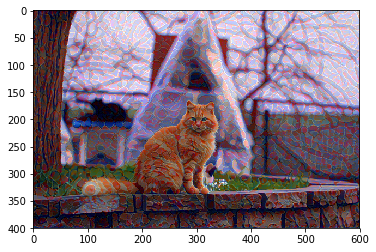

Total loss:  168754.734375


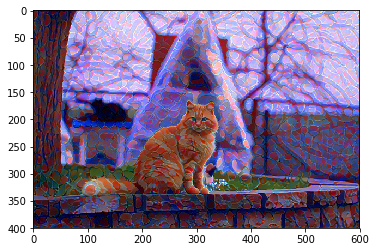

Total loss:  74671.578125


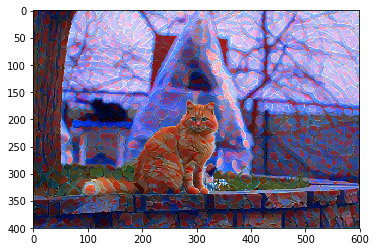

Total loss:  46984.046875


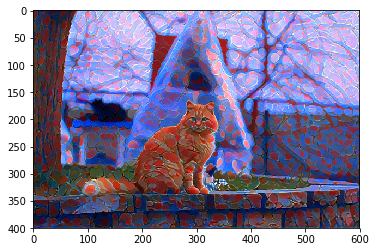

Total loss:  33138.28515625


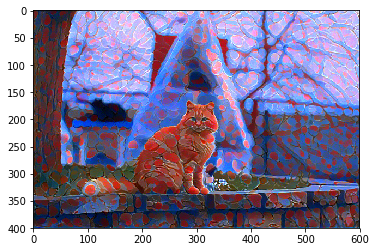

Total loss:  180652.140625


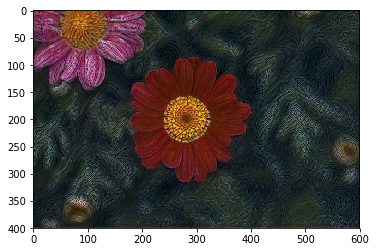

Total loss:  118876.046875


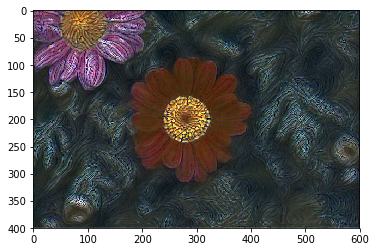

Total loss:  89566.4375


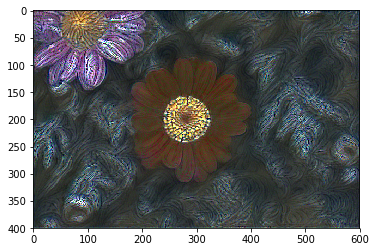

Total loss:  71084.09375


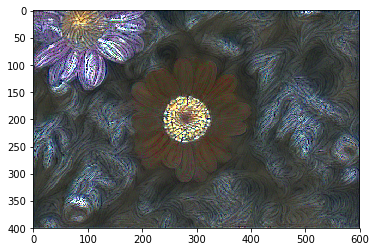

Total loss:  57564.015625


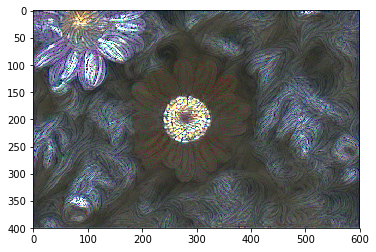

Total loss:  155206.75


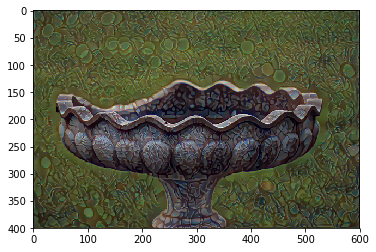

Total loss:  91919.3828125


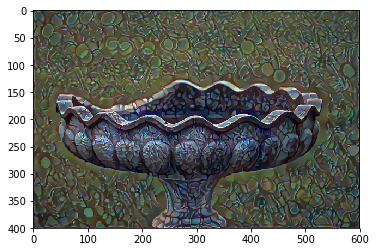

Total loss:  69823.40625


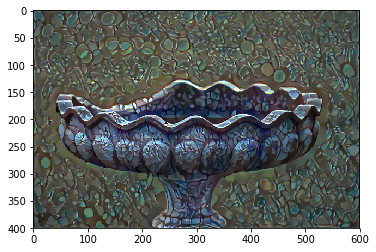

Total loss:  56681.67578125


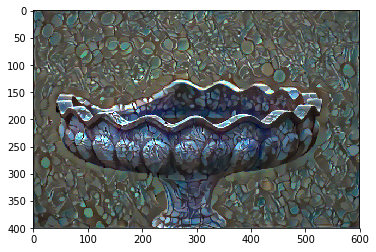

Total loss:  46831.80078125


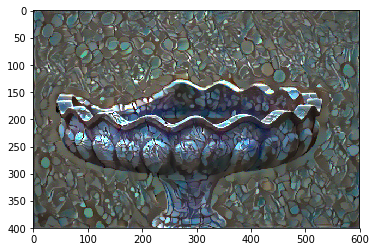

Total loss:  53402.046875


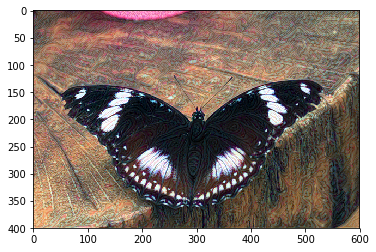

Total loss:  22966.185546875


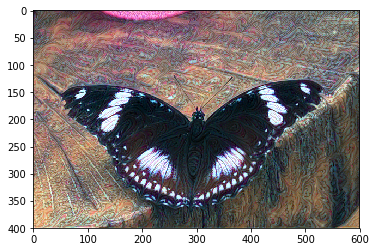

Total loss:  13485.84375


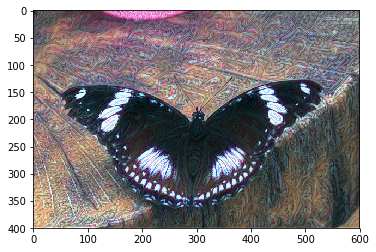

Total loss:  9128.8857421875


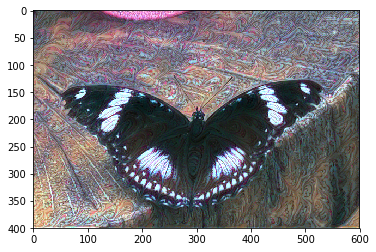

Total loss:  6585.9755859375


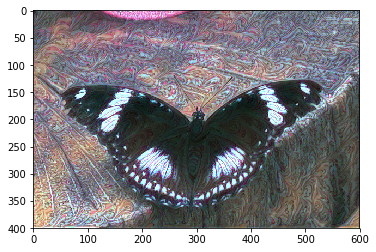

Total loss:  135703.359375


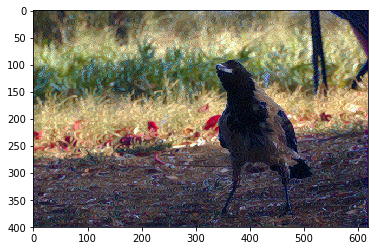

Total loss:  59500.671875


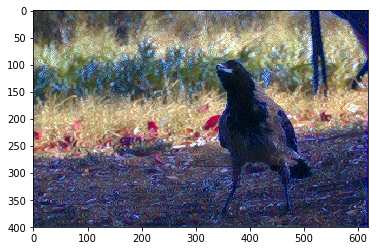

Total loss:  35292.75


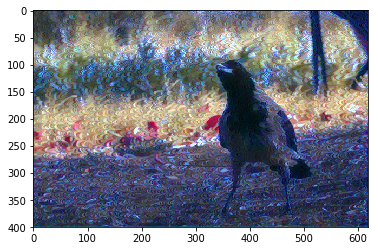

Total loss:  22255.203125


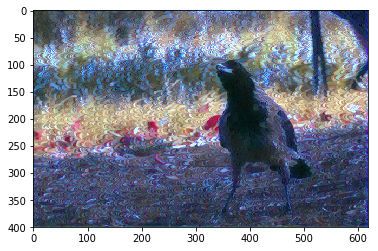

Total loss:  14189.6865234375


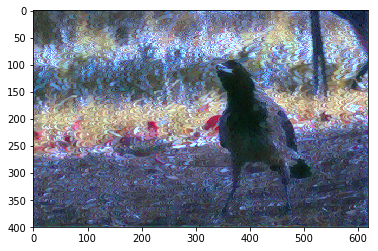

Total loss:  5347968.5


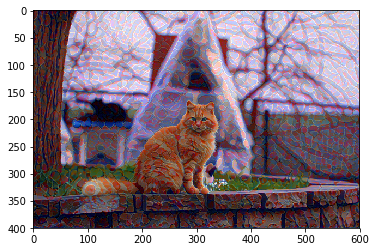

Total loss:  1687808.5


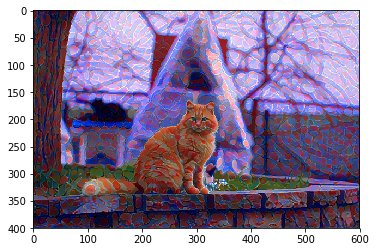

Total loss:  746720.1875


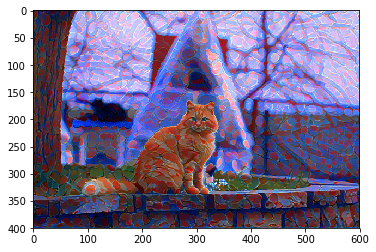

Total loss:  469840.0625


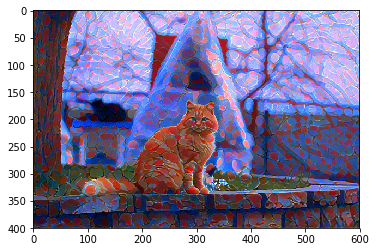

Total loss:  331507.3125


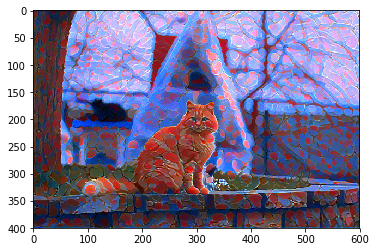

Total loss:  1806725.25


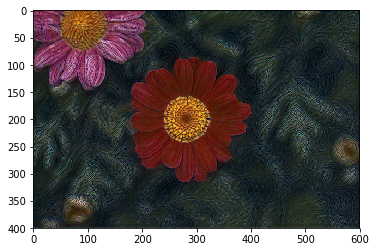

Total loss:  1188714.625


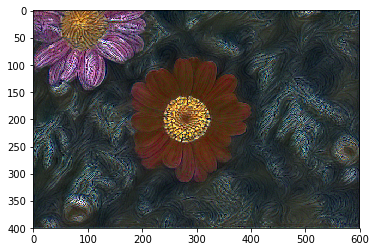

Total loss:  894998.875


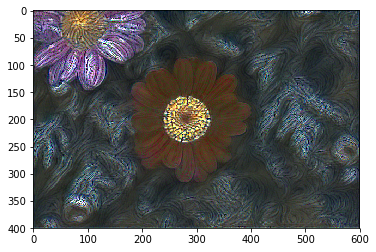

Total loss:  710276.0625


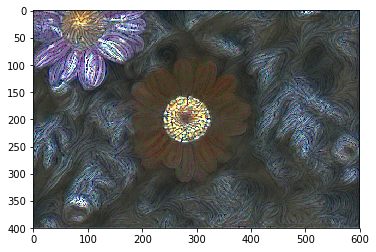

Total loss:  575044.0


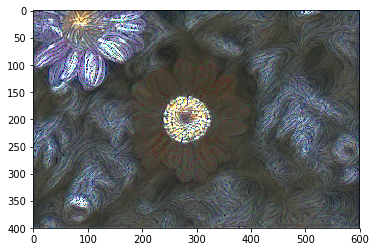

Total loss:  1551892.875


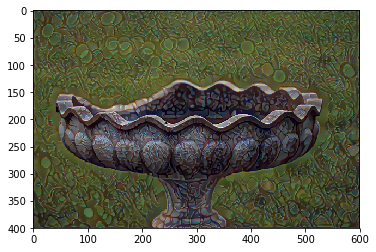

Total loss:  918949.125


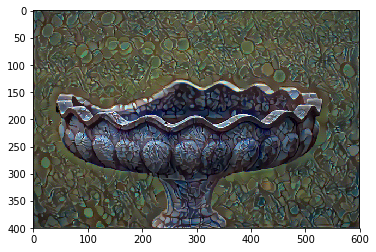

Total loss:  698278.25


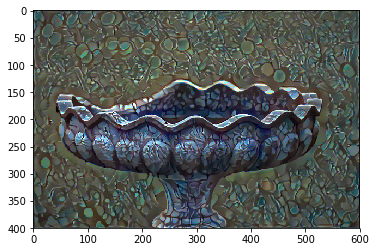

Total loss:  566231.875


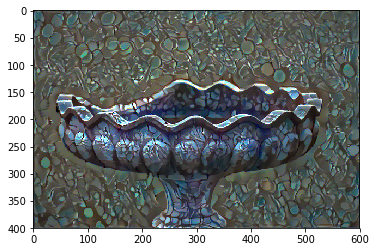

Total loss:  467575.375


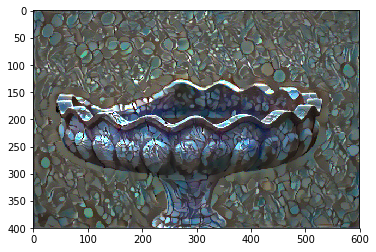

Total loss:  533925.5625


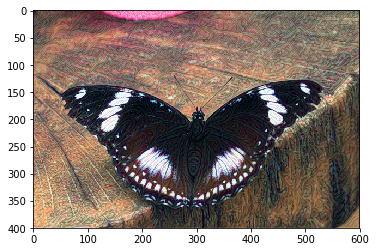

Total loss:  229633.578125


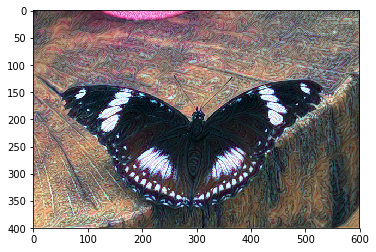

Total loss:  134805.734375


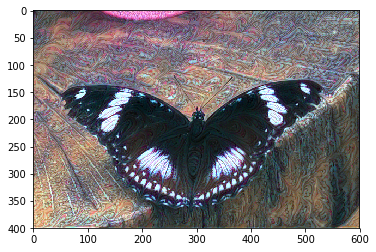

Total loss:  91226.6953125


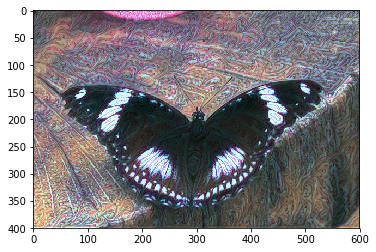

Total loss:  65827.9609375


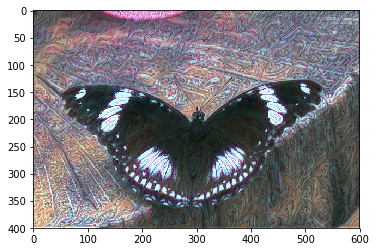

Total loss:  1356963.625


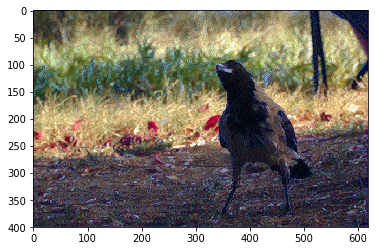

Total loss:  594941.75


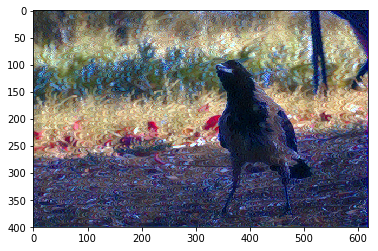

Total loss:  352788.6875


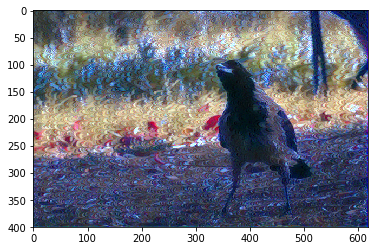

Total loss:  222564.46875


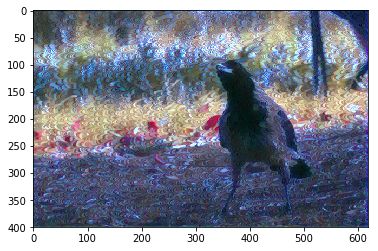

Total loss:  141943.921875


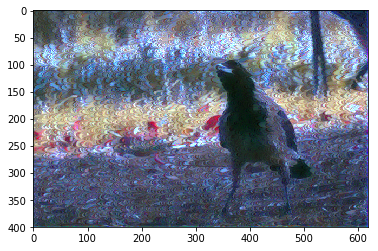

Total loss:  534679.0


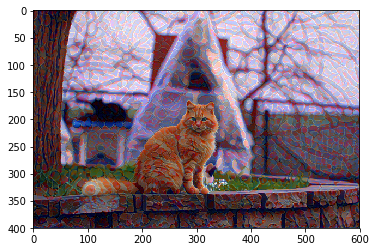

Total loss:  168762.90625


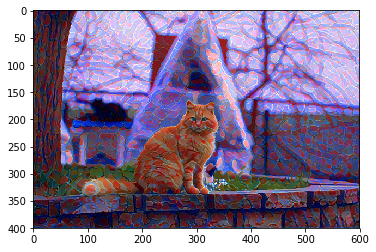

Total loss:  74683.90625


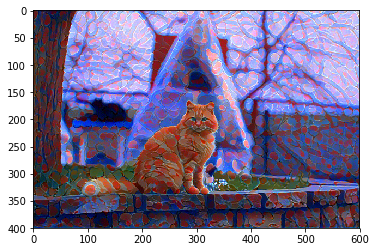

Total loss:  47064.2109375


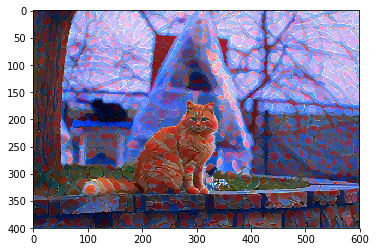

Total loss:  33258.83984375


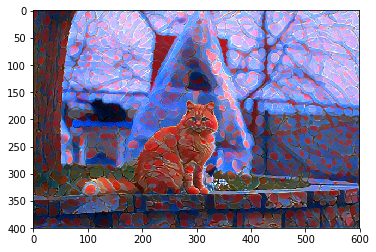

Total loss:  180736.65625


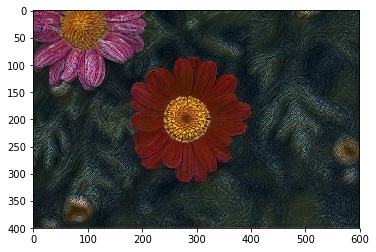

Total loss:  118885.8984375


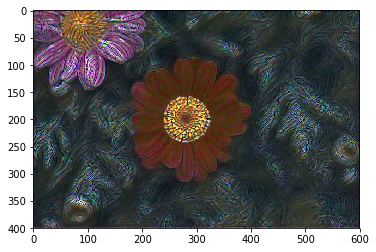

Total loss:  89514.6953125


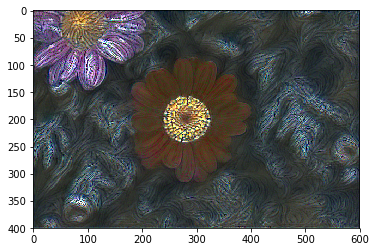

Total loss:  71065.75


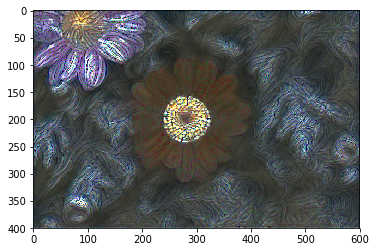

Total loss:  57593.7265625


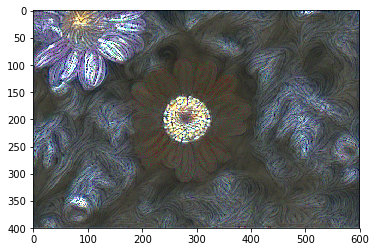

Total loss:  155304.03125


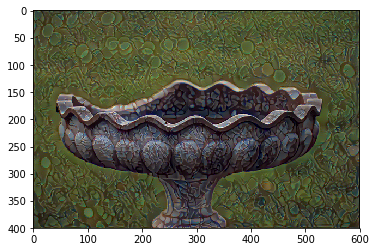

Total loss:  91969.453125


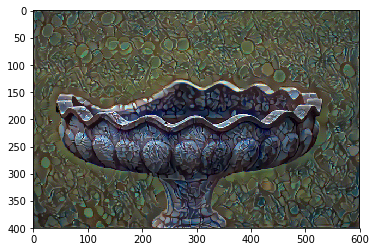

Total loss:  69958.328125


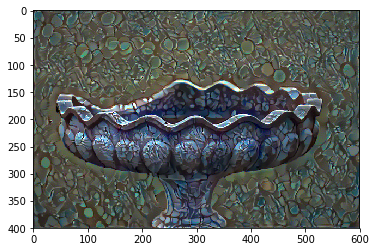

Total loss:  56717.98046875


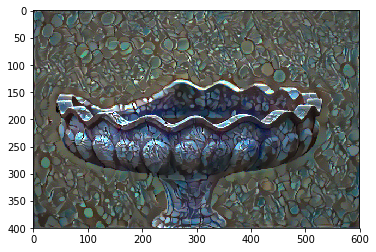

Total loss:  46853.1796875


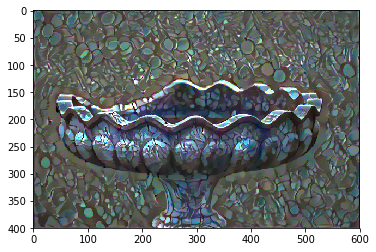

Total loss:  53453.4921875


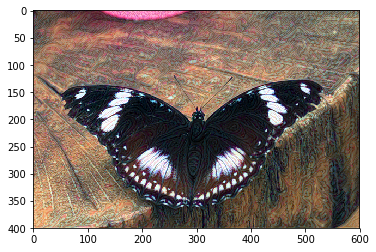

Total loss:  23018.08203125


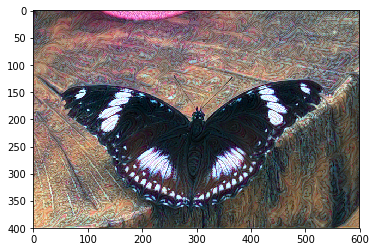

Total loss:  13540.5791015625


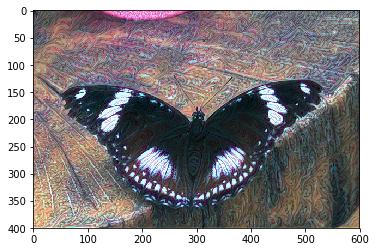

Total loss:  9188.4501953125


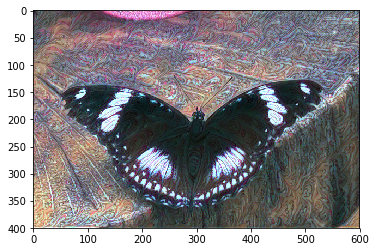

Total loss:  6647.49658203125


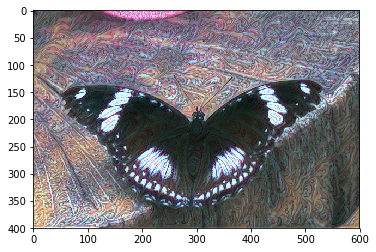

Total loss:  135751.40625


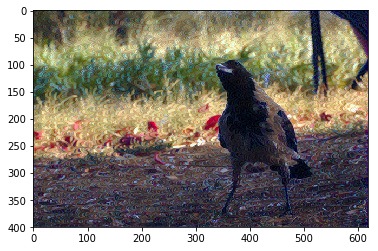

Total loss:  59550.31640625


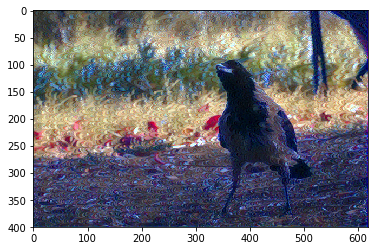

Total loss:  35333.8125


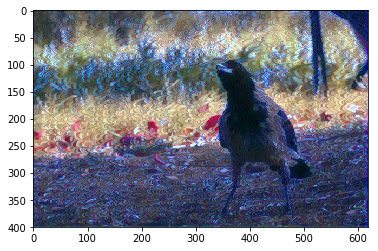

Total loss:  22311.10546875


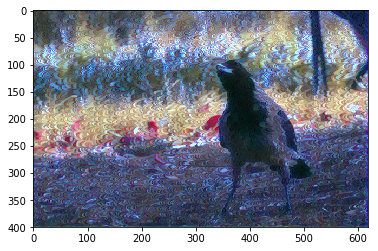

Total loss:  14244.3828125


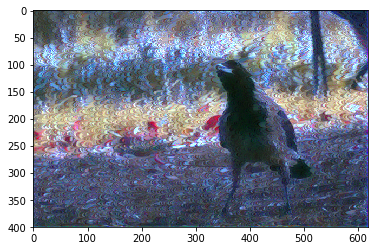

Total loss:  5347477.5


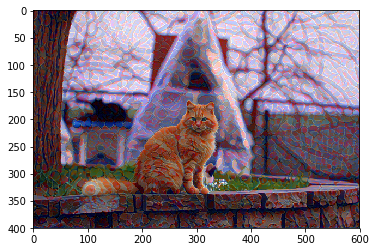

Total loss:  1686795.75


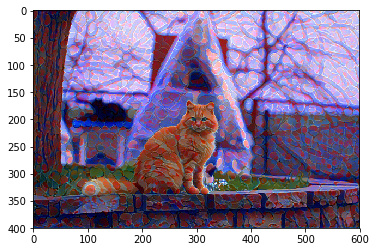

Total loss:  746506.75


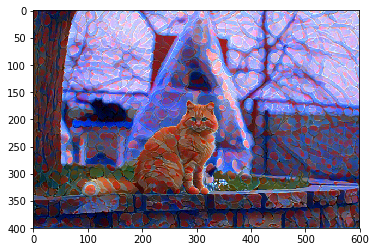

Total loss:  469885.84375


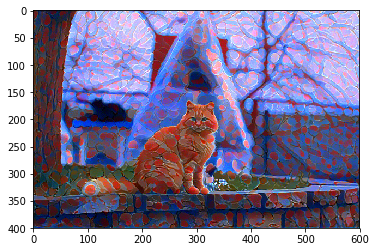

Total loss:  331411.8125


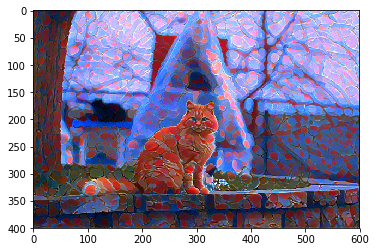

Total loss:  1806703.625


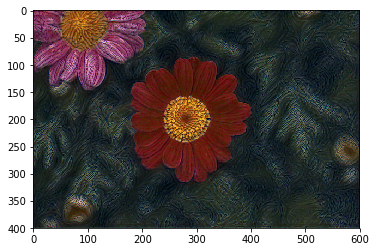

Total loss:  1189014.375


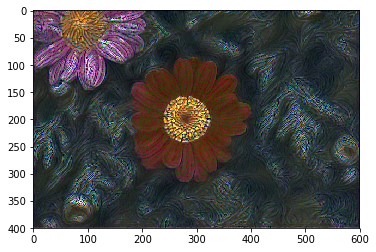

Total loss:  895852.3125


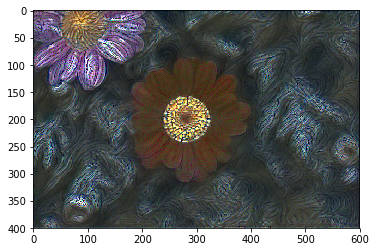

Total loss:  711088.4375


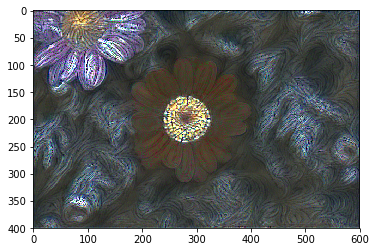

Total loss:  575848.1875


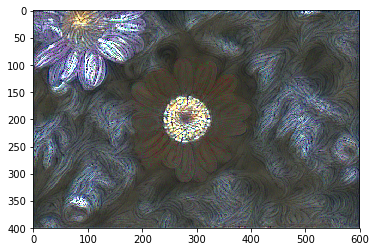

Total loss:  1552454.625


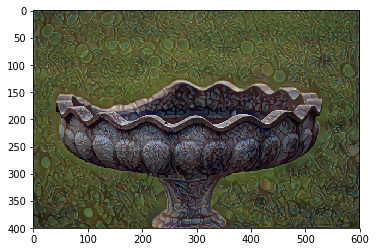

Total loss:  918498.375


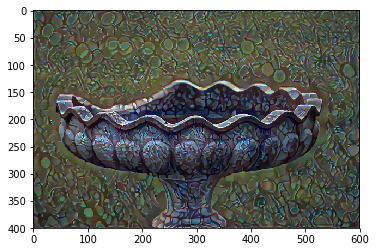

Total loss:  698223.6875


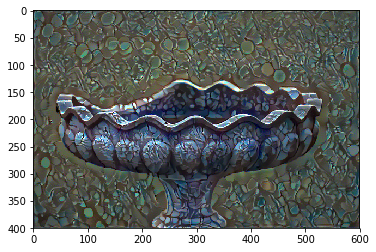

Total loss:  566935.0


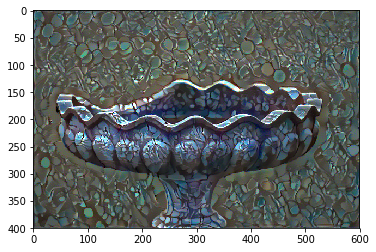

Total loss:  468808.78125


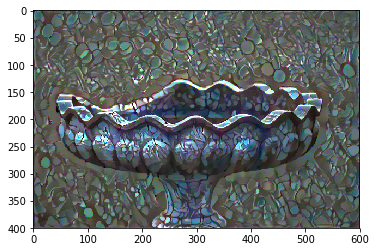

Total loss:  533911.125


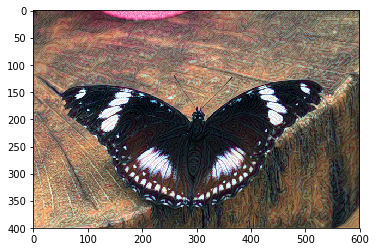

Total loss:  229607.984375


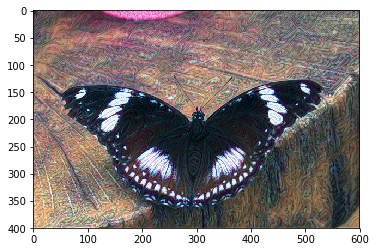

Total loss:  134815.203125


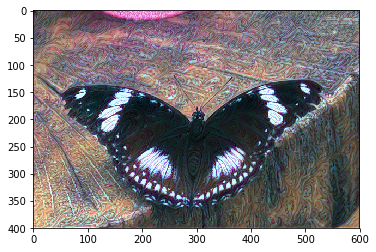

Total loss:  91249.9921875


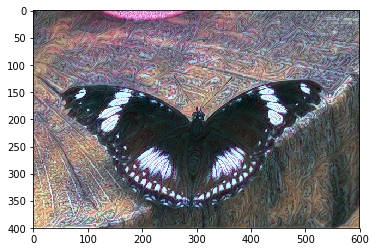

Total loss:  65834.3203125


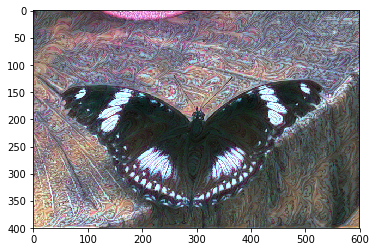

Total loss:  1356982.625


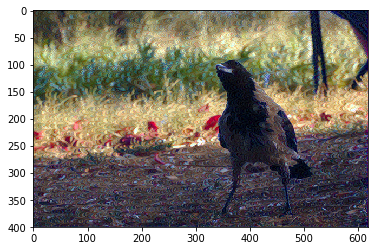

Total loss:  594784.5


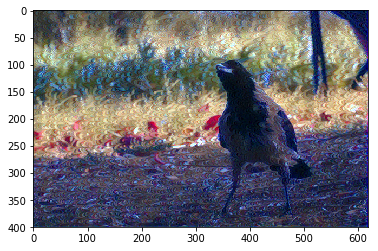

Total loss:  352733.875


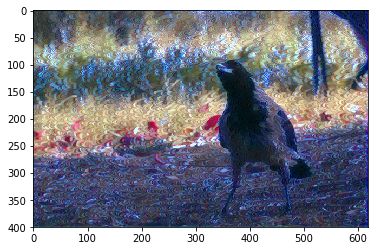

Total loss:  222479.265625


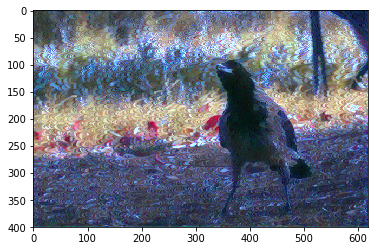

Total loss:  141854.640625


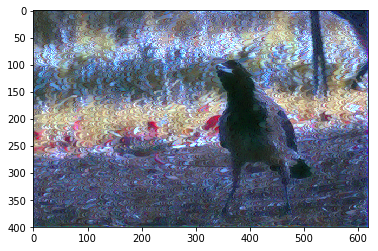

In [12]:
for content_w, style_w in zip(content_ws, style_ws):
    for i in range(len(contents)):
        content_features = get_features(contents[i], vgg)
        style_features = get_features(styles[i], vgg)

        # calculate the gram matrices for each layer of our style representation
        style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

        # create a third "target" image and prep it for change
        # it is a good idea to start of with the target as a copy of our *content* image
        # then iteratively change its style
        target = contents[i].clone().requires_grad_(True).to(device)
        train_model(content_w, style_w)

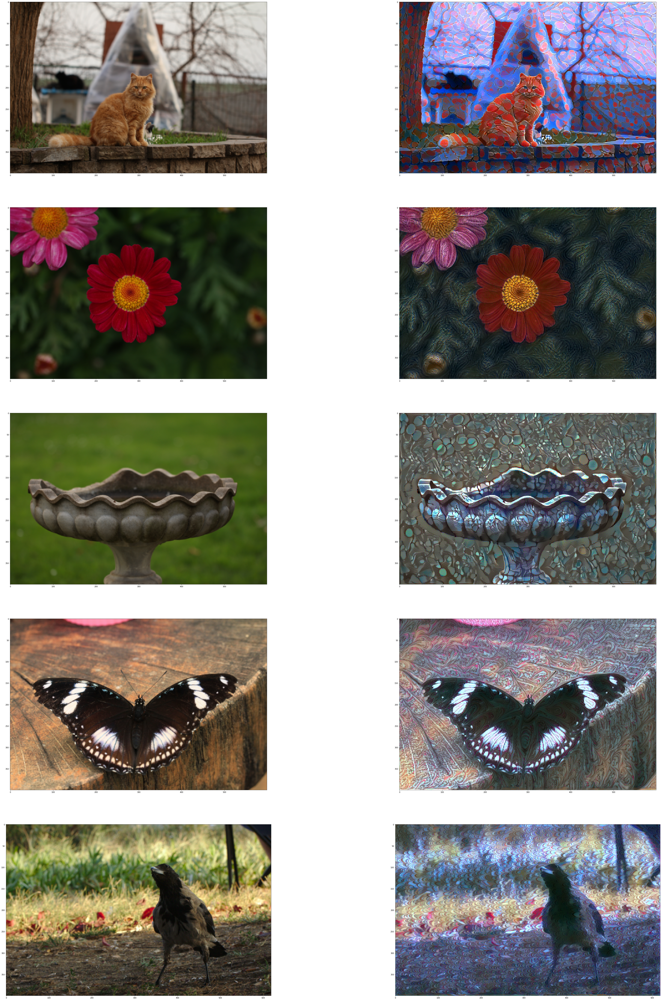

In [13]:
# display the images
fig, axs = plt.subplots(5, 2, figsize=(70, 100))
# content and style ims side-by-side

axs[0][0].imshow(im_convert(contents[0]))
axs[0][1].imshow(targets[4])

axs[1][0].imshow(im_convert(contents[1]))
axs[1][1].imshow(targets[30])

axs[2][0].imshow(im_convert(contents[2]))
axs[2][1].imshow(targets[39])

axs[3][0].imshow(im_convert(contents[3]))
axs[3][1].imshow(targets[69])

axs[4][0].imshow(im_convert(contents[4]))
axs[4][1].imshow(targets[99])

In [14]:
for i in range(len(targets)):
    im_path = 'targets/{0}.jpg'.format(i)
    plt.imsave(im_path,targets[i])

In [45]:
import csv
 
with open('results.csv', 'w') as csvfile:
    
    fnames = ["Target_Name","Content_Weigh","Style_Weight","Content_Loss","Style_Loss","Total_Loss"]
    writer = csv.DictWriter(csvfile, delimiter=',',fieldnames=fnames) 
    writer.writeheader()
    
    for i in range(len(weights_losses)):
        name = str(i)+'.jpg'
        writer.writerow({"Target_Name": name,
                         "Content_Weigh": weights_losses[i][0],
                         "Style_Weight" : weights_losses[i][1],
                         "Content_Loss" : float(weights_losses[i][2]),
                         "Style_Loss" : float(weights_losses[i][3]),
                         "Total_Loss" :float(weights_losses[i][4])})